In [1]:
# %pip install numpy matplotlib tifffile lxml

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tifffile import TiffFile, imread, imwrite
from lxml import etree
import json
from pprint import pprint
import xml.dom.minidom

## Reading TIFF File 

TIFF, which stands for Tagged Image File Format, is a flexible and adaptable file format for storing images and data within a single file. It can be used to store multiple frames as `pages`.

**Example** Read `data_endoscope.tif`. How many frames does it have?

In [3]:
frames = imread('../data/data_endoscope.tif')
frames.shape

(1000, 128, 128)

Read `Sue_2x_3000_40_-46.tif`. How many frames does this data have?

In [4]:
frames = imread('../data/Sue_2x_3000_40_-46.tif')
frames.shape

(3000, 170, 170)

Read `Sue_2x_3000_40_-46.tif`. How long does it take?

Hint: Put `%%timeit` in the beginning of the cell

In [5]:
%%timeit
frames = imread('../data/Sue_2x_3000_40_-46.tif')

118 ms ± 3.76 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


Read `Sue_2x_3000_40_-46.tif`. How long does it take to access the last frame?

Hint: Put `%%timeit` in the beginning of the cell

In [6]:
%%timeit
frames = imread('../data/Sue_2x_3000_40_-46.tif')
frames[-1]

118 ms ± 4.35 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


**Example** Let's see the plots. Plot the first frame

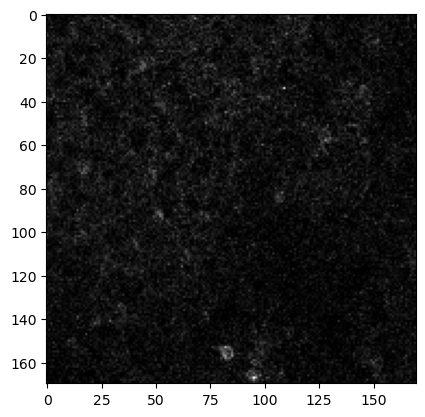

In [7]:
plt.imshow(frames[0], cmap='gray')

Plot the last frame

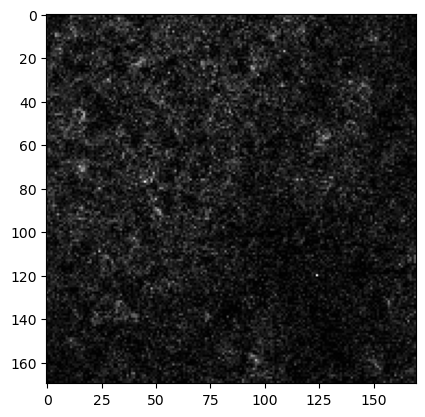

In [8]:
plt.imshow(frames[-1], cmap='gray')

**Example** Read only the first 3 frames from `Sue_2x_3000_40_-46.tif`

In [9]:
frames = imread('../data/Sue_2x_3000_40_-46.tif', key=(0, 1, 2))
frames.shape

(3, 170, 170)

Read only 1, 3, 5, 7, 9th frame from `Sue_2x_3000_40_-46.tif`

In [10]:
frames = imread('../data/Sue_2x_3000_40_-46.tif', key=(0, 2, 4, 6, 8))
frames.shape

(5, 170, 170)

Read only first 100 frames from `Sue_2x_3000_40_-46.tif`

Hint: use range(0, 100)

In [11]:
frames = imread('../data/Sue_2x_3000_40_-46.tif', key=range(0, 100))
frames.shape

(100, 170, 170)

**Example** Read `data_endoscope.tif` with `TiffFile`?

In [12]:
f = TiffFile('../data/data_endoscope.tif')
frames = np.array([page.asarray() for page in f.pages])

Read `Sue_2x_3000_40_-46.tif` with TiffFile

In [13]:
f = TiffFile('../data/Sue_2x_3000_40_-46.tif')
frames = np.array([page.asarray() for page in f.pages])

How long does it take to read `Sue_2x_3000_40_-46.tif` with TiffFile?

In [14]:
%%timeit
f = TiffFile('../data/Sue_2x_3000_40_-46.tif')
frames = np.array([page.asarray() for page in f.pages])

559 ms ± 68.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


How long does it take to access only the last frame with TiffFile?

In [15]:
%%timeit
f = TiffFile("../data/data_endoscope.tif") 
f.pages[-1].asarray()

7.06 ms ± 747 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


## Metadata handling and TIFF file writing 

In [16]:
f = TiffFile('../data/data_endoscope.tif')
print(f)

TiffFile 'data_endoscope.tif'  31.68 MiB  1000 Pages  uniform


In [17]:
f = TiffFile('../data/Sue_2x_3000_40_-46.tif')
print(f)

TiffFile 'Sue_2x_3000_40_-46.tif'  331.13 MiB  3000 Pages  shaped|uniform


In [18]:
f = TiffFile('../data/data_endoscope.tif')
print(f.pages[0].tags)

TiffTag 256 ImageWidth @33024 SHORT @33032 = 128
TiffTag 257 ImageLength @33036 SHORT @33044 = 128
TiffTag 258 BitsPerSample @33048 SHORT @33056 = 16
TiffTag 259 Compression @33060 SHORT @33068 = PACKBITS
TiffTag 262 PhotometricInterpretation @33072 SHORT @33080 = MINISBLACK
TiffTag 273 StripOffsets @33084 LONG[2] @33220 = (8, 16509)
TiffTag 274 Orientation @33096 SHORT @33104 = TOPLEFT
TiffTag 277 SamplesPerPixel @33108 SHORT @33116 = 1
TiffTag 278 RowsPerStrip @33120 SHORT @33128 = 64
TiffTag 279 StripByteCounts @33132 LONG[2] @33212 = (16501, 16512)
TiffTag 282 XResolution @33144 RATIONAL @33196 = (72, 1)
TiffTag 283 YResolution @33156 RATIONAL @33204 = (72, 1)
TiffTag 284 PlanarConfiguration @33168 SHORT @33176 = CONTIG
TiffTag 296 ResolutionUnit @33180 SHORT @33188 = INCH


In [19]:
f = TiffFile('../data/data_endoscope.tif')
print(f.pages[499].tags)

TiffTag 256 ImageWidth @16609952 SHORT @16609960 = 128
TiffTag 257 ImageLength @16609964 SHORT @16609972 = 128
TiffTag 258 BitsPerSample @16609976 SHORT @16609984 = 16
TiffTag 259 Compression @16609988 SHORT @16609996 = PACKBITS
TiffTag 262 PhotometricInterpretation @16610000 SHORT @16610008 = MINISBLACK
TiffTag 273 StripOffsets @16610012 LONG[2] @16610148 = (16576940, 16593437)
TiffTag 274 Orientation @16610024 SHORT @16610032 = TOPLEFT
TiffTag 277 SamplesPerPixel @16610036 SHORT @16610044 = 1
TiffTag 278 RowsPerStrip @16610048 SHORT @16610056 = 64
TiffTag 279 StripByteCounts @16610060 LONG[2] @16610140 = (16497, 16512)
TiffTag 282 XResolution @16610072 RATIONAL @16610124 = (72, 1)
TiffTag 283 YResolution @16610084 RATIONAL @16610132 = (72, 1)
TiffTag 284 PlanarConfiguration @16610096 SHORT @16610104 = CONTIG
TiffTag 296 ResolutionUnit @16610108 SHORT @16610116 = INCH


In [20]:
f = TiffFile('../data/data_endoscope.tif')
print(f.pages[999].tags)

TiffTag 256 ImageWidth @33220494 SHORT @33220502 = 128
TiffTag 257 ImageLength @33220506 SHORT @33220514 = 128
TiffTag 258 BitsPerSample @33220518 SHORT @33220526 = 16
TiffTag 259 Compression @33220530 SHORT @33220538 = PACKBITS
TiffTag 262 PhotometricInterpretation @33220542 SHORT @33220550 = MINISBLACK
TiffTag 273 StripOffsets @33220554 LONG[2] @33220690 = (33187470, 33203979)
TiffTag 274 Orientation @33220566 SHORT @33220574 = TOPLEFT
TiffTag 277 SamplesPerPixel @33220578 SHORT @33220586 = 1
TiffTag 278 RowsPerStrip @33220590 SHORT @33220598 = 64
TiffTag 279 StripByteCounts @33220602 LONG[2] @33220682 = (16509, 16512)
TiffTag 282 XResolution @33220614 RATIONAL @33220666 = (72, 1)
TiffTag 283 YResolution @33220626 RATIONAL @33220674 = (72, 1)
TiffTag 284 PlanarConfiguration @33220638 SHORT @33220646 = CONTIG
TiffTag 296 ResolutionUnit @33220650 SHORT @33220658 = INCH


In [21]:
f = TiffFile('../data/data_endoscope.tif')
print(f.pages[999].tags['ImageWidth'].value)

128


In [22]:
f = TiffFile('../data/data_endoscope.tif')
print(f.pages[999].tags['PhotometricInterpretation'].value)

PHOTOMETRIC.MINISBLACK


In [23]:
f = TiffFile('../data/data_endoscope.tif')
print(f.pages[999].tags['ResolutionUnit'].value)

RESUNIT.INCH


In [24]:
frame1 = np.random.rand(100, 100)  # Frame 1
frame2 = np.random.rand(100, 100)  # Frame 2
frame3 = np.random.rand(100, 100)  # Frame 3

In [25]:
tiff_path = 'output/output_file.tiff'
imwrite(tiff_path, [frame1, frame2, frame3], photometric='minisblack')

f = TiffFile('output/output_file.tiff')
print(f)

TiffFile 'output_file.tiff'  234.99 KiB  3 Pages  shaped|uniform


In [26]:
tiff_path = 'output/output_file.tiff'
imwrite(tiff_path, [frame1, frame2, frame3], photometric='minisblack')

f = TiffFile('output/output_file.tiff')
print(f.pages[-1].tags)

TiffTag 256 ImageWidth @240452 LONG @240460 = 100
TiffTag 257 ImageLength @240464 LONG @240472 = 100
TiffTag 258 BitsPerSample @240476 SHORT @240484 = 64
TiffTag 259 Compression @240488 SHORT @240496 = NONE
TiffTag 262 PhotometricInterpretation @240500 SHORT @240508 = MINISBLACK
TiffTag 273 StripOffsets @240512 LONG @240520 = (160272,)
TiffTag 277 SamplesPerPixel @240524 SHORT @240532 = 1
TiffTag 278 RowsPerStrip @240536 LONG @240544 = 100
TiffTag 279 StripByteCounts @240548 LONG @240556 = (80000,)
TiffTag 282 XResolution @240560 RATIONAL @240434 = (1, 1)
TiffTag 283 YResolution @240572 RATIONAL @240442 = (1, 1)
TiffTag 296 ResolutionUnit @240584 SHORT @240592 = NONE
TiffTag 339 SampleFormat @240596 SHORT @240604 = IEEEFP


In [27]:
tiff_path = 'output/output_file.tiff'
imwrite(tiff_path, [frame1, frame2, frame3], photometric='rgb')

f = TiffFile('output/output_file.tiff')
print(f.pages[-1].tags['PhotometricInterpretation'].value)

PHOTOMETRIC.RGB


In [28]:
metadata = {
    'Experiment': 'Calcium Imaging',
}
metadata_json = json.dumps(metadata)
tiff_path = 'output/output_file.tiff'
imwrite(tiff_path, [frame1, frame2, frame3], description=metadata_json)

f = TiffFile('output/output_file.tiff')
print(f.pages[0].tags['ImageDescription'].value)

{"Experiment": "Calcium Imaging"}


In [29]:
metadata = {
    'Experiment': 'Calcium Imaging',
    'Date': '2024-02-25'
}
metadata_json = json.dumps(metadata)
tiff_path = 'output/output_file.tiff'
imwrite(tiff_path, [frame1, frame2, frame3], description=metadata_json)

f = TiffFile('output/output_file.tiff')
print(f.pages[0].tags['ImageDescription'].value)

{"Experiment": "Calcium Imaging", "Date": "2024-02-25"}


In [30]:
metadata = {
    'Experiment': 'Calcium Imaging',
    'Date': '2024-02-25',
    'Researcher': 'Sangee'
}
metadata_json = json.dumps(metadata)
tiff_path = 'output/output_file.tiff'
imwrite(tiff_path, [frame1, frame2, frame3], description=metadata_json)

f = TiffFile('output/output_file.tiff')
print(f.pages[0].tags['ImageDescription'].value)

{"Experiment": "Calcium Imaging", "Date": "2024-02-25", "Researcher": "Sangee"}


## OME data model and structure


**Example** Read and print OME metadata from output_file.tiff. Is there any?

In [31]:
f = TiffFile('output/output_file.tiff')
ome_metadata = f.ome_metadata
print(ome_metadata)

None


Read and print ome metadata of `output.ome.tiff`. Is it readable?

In [32]:
f = TiffFile('output/output.ome.tiff')
ome_metadata = f.ome_metadata
print(ome_metadata)

<?xml version="1.0" encoding="UTF-8"?><OME xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd" UUID="urn:uuid:21888a54-d402-11ee-b94e-9009df8e0d1d"  Creator="tifffile.py 2023.8.12"><Image ID="Image:0" Name="Image0"><Pixels ID="Pixels:0" DimensionOrder="XYCZT" Type="float" SizeX="100" SizeY="100" SizeC="1" SizeZ="1" SizeT="1"><Channel ID="Channel:0:0" SamplesPerPixel="1"><LightPath/></Channel><TiffData IFD="0" PlaneCount="1"/></Pixels></Image></OME>


Let's make it more readable. Instead of `print` use `pprint` which means `pretty print`

In [33]:
f = TiffFile('output/output.ome.tiff')
ome_metadata = f.ome_metadata
pprint(ome_metadata)

('<?xml version="1.0" encoding="UTF-8"?><OME '
 'xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" '
 'xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" '
 'xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 '
 'http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd" '
 'UUID="urn:uuid:21888a54-d402-11ee-b94e-9009df8e0d1d"  Creator="tifffile.py '
 '2023.8.12"><Image ID="Image:0" Name="Image0"><Pixels ID="Pixels:0" '
 'DimensionOrder="XYCZT" Type="float" SizeX="100" SizeY="100" SizeC="1" '
 'SizeZ="1" SizeT="1"><Channel ID="Channel:0:0" '
 'SamplesPerPixel="1"><LightPath/></Channel><TiffData IFD="0" '
 'PlaneCount="1"/></Pixels></Image></OME>')


Better. The format of the output is XML. XML, which stands for eXtensible Markup Language, is a markup language that defines a set of rules for encoding documents in a format that is both human-readable and machine-readable. 

**Example** Read ome metadata of output.ome.tiff and use inbuilt library `xml` to parse the string format to pretty xml. 

In [34]:
f = TiffFile('output/output.ome.tiff')
ome_metadata = f.ome_metadata
dom = xml.dom.minidom.parseString(ome_metadata) 
pprint(dom.toprettyxml())

('<?xml version="1.0" ?>\n'
 '<OME xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" '
 'xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" '
 'xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 '
 'http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd" '
 'UUID="urn:uuid:21888a54-d402-11ee-b94e-9009df8e0d1d" Creator="tifffile.py '
 '2023.8.12">\n'
 '\t<Image ID="Image:0" Name="Image0">\n'
 '\t\t<Pixels ID="Pixels:0" DimensionOrder="XYCZT" Type="float" SizeX="100" '
 'SizeY="100" SizeC="1" SizeZ="1" SizeT="1">\n'
 '\t\t\t<Channel ID="Channel:0:0" SamplesPerPixel="1">\n'
 '\t\t\t\t<LightPath/>\n'
 '\t\t\t</Channel>\n'
 '\t\t\t<TiffData IFD="0" PlaneCount="1"/>\n'
 '\t\t</Pixels>\n'
 '\t</Image>\n'
 '</OME>\n')


Read ome metadata of multifile-Z1.ome.tiff and use inbuilt library `xml` to parse the string format to pretty xml 

In [35]:
f = TiffFile('../data/multifile-Z1.ome.tiff')
ome_metadata = f.ome_metadata
dom = xml.dom.minidom.parseString(ome_metadata) 
pprint(dom.toprettyxml())

('<?xml version="1.0" ?>\n'
 '<!-- Warning: this comment is an OME-XML metadata block, which contains '
 'crucial dimensional parameters and other important metadata. Please edit '
 'cautiously (if at all), and back up the original data before doing so. For '
 'more information, see the OME-TIFF web site: '
 'http://www.openmicroscopy.org/site/support/ome-model/ome-tiff/. -->\n'
 '<OME xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" '
 'xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" Creator="OME '
 'Bio-Formats 5.2.0-m4" UUID="urn:uuid:d25bfea2-2708-4a4f-bcd9-8ab1ac478041" '
 'xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 '
 'http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd">\n'
 '\t<Image ID="Image:0" Name="multifile">\n'
 '\t\t<AcquisitionDate>2010-03-02T15:08:59</AcquisitionDate>\n'
 '\t\t<Pixels BigEndian="false" DimensionOrder="XYCTZ" ID="Pixels:0:0" '
 'Type="uint8" SizeC="1" SizeT="1" SizeX="18" SizeY="24" SizeZ="5">\n'
 '\t\t\t<

https://downloads.openmicroscopy.org/images/OME-TIFF/2016-06/MitoCheck/

Let's use `00001_01.ome.tiff` for the rest of the exercises. Read its metadata and pretty print in pretty xml.

Looking through its data, what are the X, Y, and temporal dimensions?

In [36]:
f = TiffFile('output/00001_01.ome.tiff')
ome_metadata = f.ome_metadata
dom = xml.dom.minidom.parseString(ome_metadata) 
pprint(dom.toprettyxml())

('<?xml version="1.0" ?>\n'
 '<!-- Warning: this comment is an OME-XML metadata block, which contains '
 'crucial dimensional parameters and other important metadata. Please edit '
 'cautiously (if at all), and back up the original data before doing so. For '
 'more information, see the OME-TIFF web site: '
 'http://www.openmicroscopy.org/site/support/ome-model/ome-tiff/. -->\n'
 '<OME xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" '
 'xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" Creator="OME '
 'Bio-Formats 5.2.4" UUID="urn:uuid:2c7a951e-2fdb-4e58-8620-c8a782bef30a" '
 'xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 '
 'http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd">\n'
 '\t<Plate ID="Plate:0" '
 'Name="LT0001_02--ex2005_11_16--sp2005_02_17--tt17--c3">\n'
 '\t\t<Well Column="0" ExternalIdentifier="00001" ID="Well:0" Row="0">\n'
 '\t\t\t<WellSample ID="WellSample:0" Index="1">\n'
 '\t\t\t\t<ImageRef ID="Image:0"/>\n'
 '\t\t\t</Well

Confirm the dimensions by checking shape of the image data

In [37]:
f = TiffFile('output/00001_01.ome.tiff')
image_data = f.asarray()
image_data.shape

(93, 1024, 1344)

**Example** It's been a while since we visualized something! Let's see how the first frame looks like? What kind of data is this?

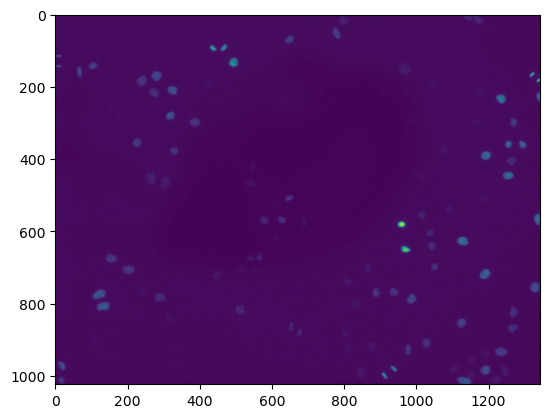

In [38]:
f = TiffFile('output/00001_01.ome.tiff')
image_data = f.asarray()
plt.imshow(image_data[0]);

Let's see how the second frame looks like.

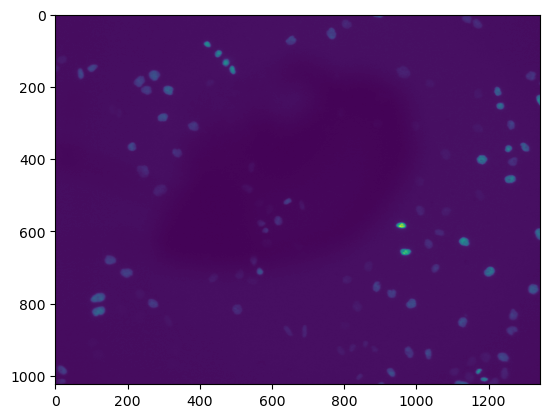

In [39]:
f = TiffFile('output/00001_01.ome.tiff')
image_data = f.asarray()
plt.imshow(image_data[1]);

Let's see how the last frame looks like.

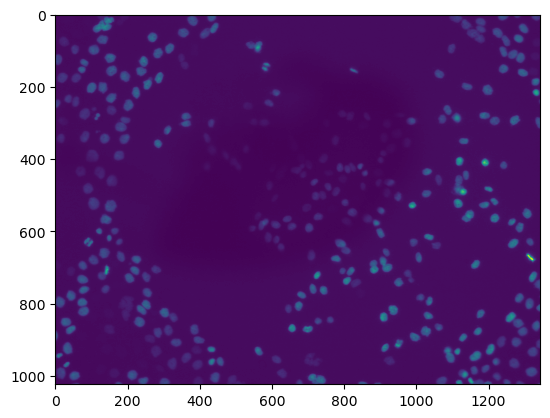

In [40]:
f = TiffFile('output/00001_01.ome.tiff')
image_data = f.asarray()
plt.imshow(image_data[-1]);

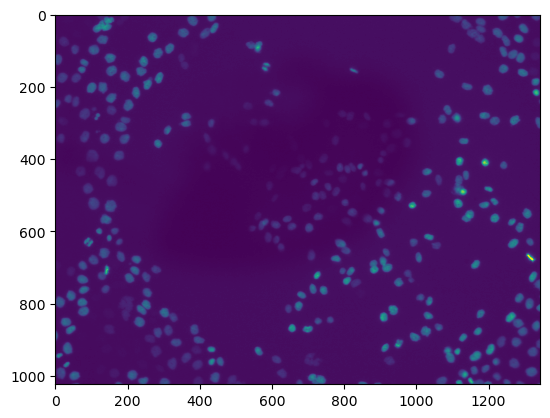

In [41]:
from matplotlib.animation import FuncAnimation

frames = image_data.copy()

fig, ax = plt.subplots()
frame = frames[0]  
im = ax.imshow(frame, animated=True)

def update(frame):
    im.set_array(frame)
    return [im]

ani = FuncAnimation(fig, update, frames=frames, blit=True, interval=50);

from IPython.display import HTML
HTML(ani.to_jshtml())


## Writing OME Data and metadata

In [46]:
frame1 = np.random.rand(100, 100)  # Frame 1

In [47]:
metadata = {
    'Experiment': 'Calcium Imaging',
}
tiff_path = 'output/output.ome.tiff'
imwrite(tiff_path, [frame1, frame2, frame3], metadata={'Description': str(metadata)})

f = TiffFile('output/output.ome.tiff')
ome_metadata = f.ome_metadata
pprint(ome_metadata)

('<?xml version="1.0" encoding="UTF-8"?><OME '
 'xmlns="http://www.openmicroscopy.org/Schemas/OME/2016-06" '
 'xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" '
 'xsi:schemaLocation="http://www.openmicroscopy.org/Schemas/OME/2016-06 '
 'http://www.openmicroscopy.org/Schemas/OME/2016-06/ome.xsd" '
 'UUID="urn:uuid:dc49c107-d407-11ee-935e-9009df8e0d1d"  Creator="tifffile.py '
 '2023.8.12"><Image ID="Image:0" Name="Image0"><Description>{\'Experiment\': '
 '\'Calcium Imaging\'}</Description><Pixels ID="Pixels:0" '
 'DimensionOrder="XYCZT" Type="double" SizeX="100" SizeY="100" SizeC="3" '
 'SizeZ="1" SizeT="1"><Channel ID="Channel:0:0" '
 'SamplesPerPixel="1"><LightPath/></Channel><Channel ID="Channel:0:1" '
 'SamplesPerPixel="1"><LightPath/></Channel><Channel ID="Channel:0:2" '
 'SamplesPerPixel="1"><LightPath/></Channel><TiffData IFD="0" '
 'PlaneCount="3"/></Pixels></Image></OME>')


Is there any software that can help with this? YES!

Use Bio-Format Importer from Plugins tab in ImageJ to import `00001_01.ome.tiff`. 


It might take a while to laod. Check `open xml`. Feel free to explore other options 